In [1]:
classes = ['MEL', 'NV', 'BCC', 'AK', 'BKL', 'DF', 'VASC', 'SCC', 'UNK']

Sample images in MEL class:


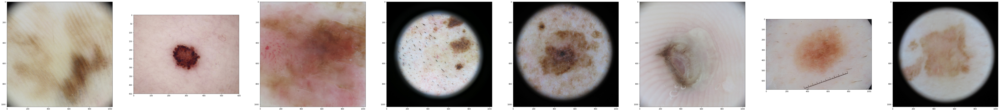

Sample images in NV class:


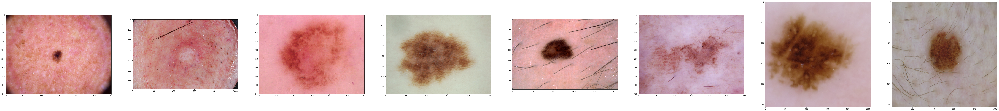

Sample images in BCC class:


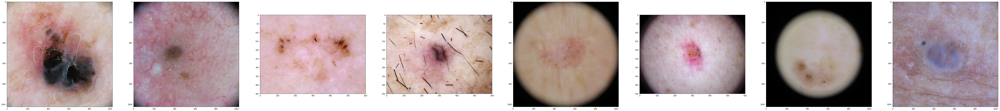

Sample images in AK class:


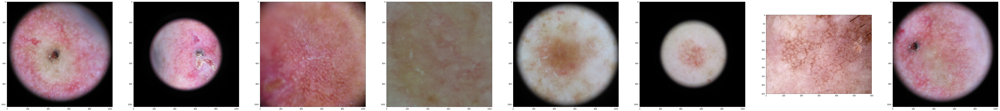

Sample images in BKL class:


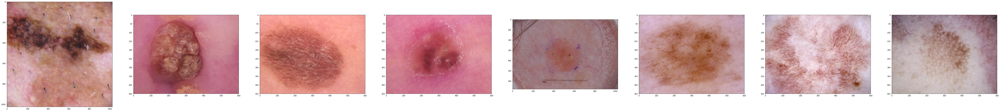

Sample images in DF class:


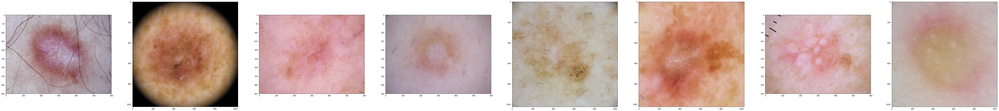

Sample images in VASC class:


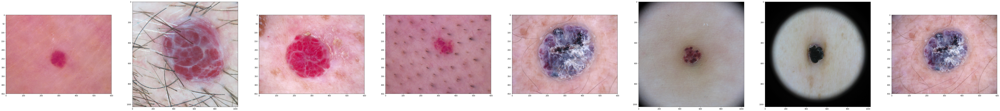

Sample images in SCC class:


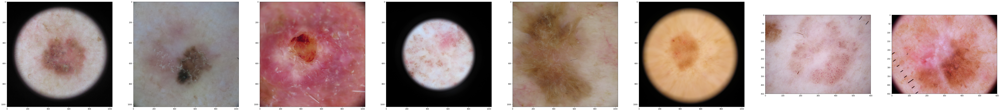

In [3]:
import glob
from random import sample
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

# from IPython.display import Image, display

sample_number = 8

for class_label in range(8):
    print("Sample images in %s class:" % classes[class_label])
    
    # random sample 5 images per class
    images = []
    for img_path in sample(glob.glob('data/isic2019/isic2019_training/%s/*.jpg' % classes[class_label]), sample_number):
        images.append(mpimg.imread(img_path))

    plt.figure(figsize=(100, 100))
    for i, image in enumerate(images):
        plt.subplot(len(images) / sample_number + 1, sample_number, i + 1)
        plt.imshow(image)
    
    plt.show(block=False)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


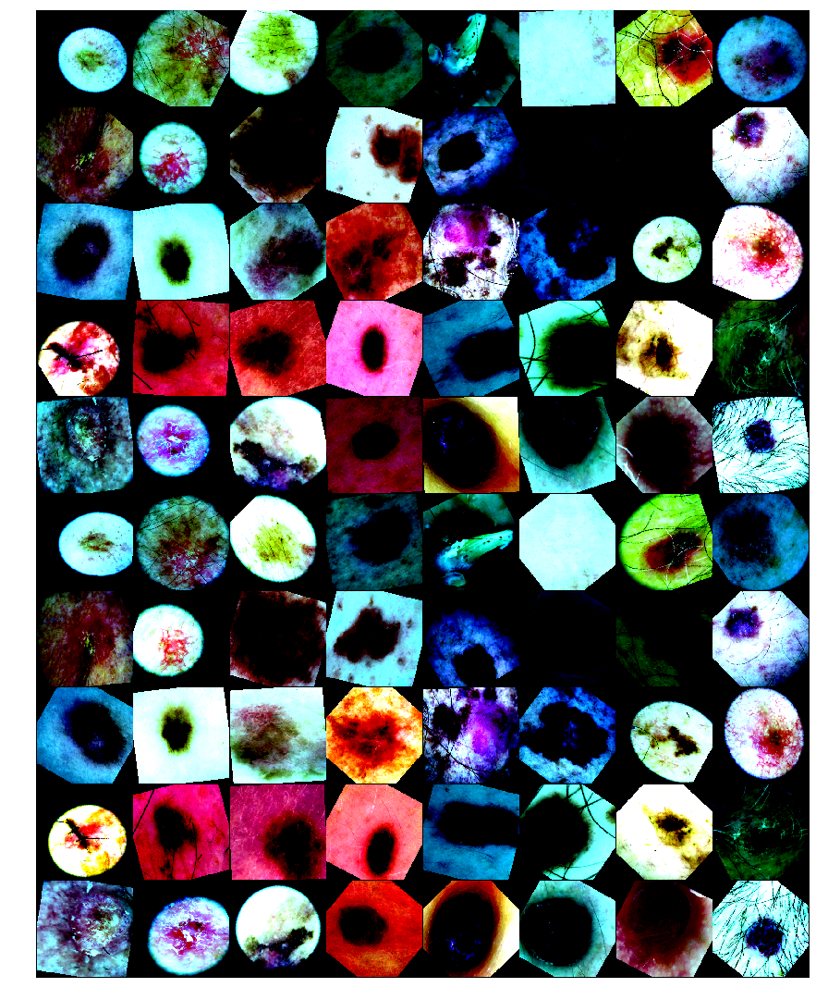

In [31]:
import numpy as np

import torch
from torchvision import datasets, transforms
from torchvision.utils import make_grid

import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
mpl.rcParams['image.interpolation'] = 'nearest'
mpl.rcParams['figure.figsize'] = 15, 25

def show_dataset(dataset, n=2):
    imgs = torch.stack([dataset[i][0] for _ in range(n)
                       for i in range(len(dataset))])
    grid = make_grid(imgs).numpy()
    plt.imshow(np.transpose(grid, (1, 2, 0)), interpolation='nearest')
    plt.axis('off')

# normalization for imagenet
normalize = transforms.Normalize(mean=[0.6803108, 0.5250009, 0.5146185], std=[0.18023035, 0.18443975, 0.19847354])

train_transform = transforms.Compose([transforms.RandomResizedCrop(size=(224, 224), scale=(0.5, 1.0)),
                                     transforms.ColorJitter(brightness=0.05, contrast=0.05, saturation=0.05, hue=0.05),
                                     transforms.RandomHorizontalFlip(),
                                     transforms.RandomVerticalFlip(),
                                     transforms.RandomRotation(180),
                                     transforms.ToTensor(),
                                     normalize])

isic2019_train_data = datasets.ImageFolder(root='data/isic2019/isic2019_visualization', transform=train_transform)

show_dataset(isic2019_train_data)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


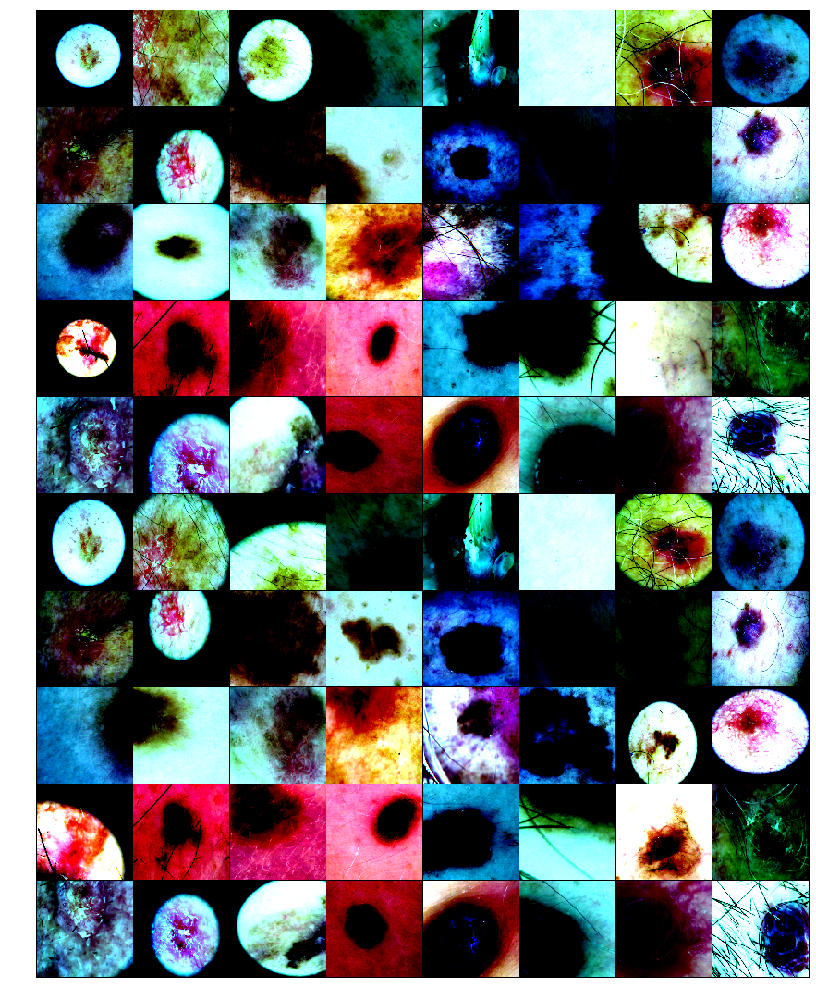

In [32]:
test_transform = transforms.Compose([transforms.RandomResize(size=(224, 224)),
                                     transforms.ToTensor(),
                                     normalize])

isic2019_test_data = datasets.ImageFolder(root='data/isic2019/isic2019_visualization', transform=test_transform)

show_dataset(isic2019_test_data)